# Land Use, Transit Flows and Demographic Patterns

Nutvara J, Kaitlyn Ng, Kittibhum Tasanasuwan

# 1. Background

Transportation policy-makers often face the challenge of choosing between various transportation scenarios. To do this, they need to understand the flow of origin and destination (OD) of people. King County has diverse land use, including urban areas like Seattle, small towns like Issaquah, and rural areas like Snoqualmie. With different land uses, the population demographics also vary. Therefore, understanding how demographics and land use affect travel patterns is crucial for urban planning and transportation infrastructure development.

This study aims to **analyze the correlations between travel patterns, demographics, and land use**. The study seeks to answer the following questions:

* What is the correlation between OD flows and demographics given similar land uses?
* How do land use and demographics affect the number of trips?
* Does the city provide a reasonable amount of transit to each census tract based on demographics and land use types?


# 2. Data & Methods
### Data
Our data came from three sources for King County in 2019.
1. Travel flow data from the *[Puget Sound Regional Council Household Travel Survey](https://www.psrc.org/our-work/household-travel-survey-program)*
   - Variables extracted: number of transit trips originating and ending in each census tract in King County
   - Workflow: created origin-destination matrix for census tracts in King County (sparsity issue), filtered data to only include transit trips
3. Land use data from *[General Land Use Final Dataset](https://geo.wa.gov/datasets/a0ddbd4e0e2141b3841a6a42ff5aff46_0/about)*
   - Variables extracted: largest land use of each census tract
   - Workflow: clipped land use data by census tract geometries to determine the land use with the largest area proportion. Validated via Google Landsat data.
<img src="exported_data/land_use_pic_zoom.png"/>
5. Demographic data from *[American Community Survey](https://www.census.gov/programs-surveys/acs)*
   - Variables extracted: various demographic data (race, income, immigration status, housing costs, mode to travel to work, etc.)
   - Workflow: identified variables of interest, queried from Census API

### Methodology
1. Conduct correlation analysis to explore patterns in demographic, land use, and transit flow variables
2. Extract interesting variables from correlation to further explore via linear regression
3. Extract interesting findings from correlation and linear regression to explore via geospatial analysis

In [1]:
# clean up notebook
import warnings
warnings.filterwarnings("ignore")

In [2]:
import geopandas as gpd
import pandas as pd
import numpy as np
import geopandas as gpd
import skmob
import matplotlib.pyplot as plt
import folium
import matplotlib.colors as colors
import statsmodels.api as sm
import seaborn as sns
import branca.colormap as cm
from branca.colormap import linear
# import ipympl

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


### Load and Merge Data

In [3]:
# Census shapefiles
census_shp = gpd.read_file('./exported_data/psrc_census_tracts.geojson')

In [4]:
# Demographic
filename = "./exported_data/demographic_data"
file = open(filename)
demo_gdf = gpd.read_file(file)
demo_gdf = demo_gdf.set_index('Tract')

In [5]:
# OD
filename = "./exported_data/county_shp_transit.geojson"
file = open(filename)
od_gdf = gpd.read_file(file)
od_gdf = od_gdf.set_index(od_gdf['tractid'].astype('string').apply(lambda x: x[-6:]))
od_gdf.index.names = ['Tract']
od_gdf = od_gdf.drop(columns='geometry')

# OD data compatible with skmob
od_transit_flows = pd.read_csv('./exported_data/tract_flow_transit.csv')

In [6]:
# Landuse
filename = "./exported_data/tract_landuse_gdf"
file = open(filename)
landuse_gdf = gpd.read_file(file)
landuse_gdf = landuse_gdf.set_index('Tract')
landuse_gdf = landuse_gdf.drop(columns='geometry')

In [7]:
all_gdf = od_gdf.join(demo_gdf, how='left')

In [8]:
all_gdf = all_gdf.join(landuse_gdf)
all_gdf = all_gdf.reset_index()

# 3. Analysis & Discussion

# 3.1 Correlation matrix between demographic and OD flow
**Correlation coefficients** are used to find how strong a relationship is between data. The formulas return a value between -1 and 1, where
* 1 indicates a strong positive relationship.
* -1 indicates a strong negative relationship.
* 0 indicates no relationship at all.
  
In this study, we want to observe the relationship between demographics and OD flows categorized by different land uses.

### Data Preparations 

In [9]:
from sklearn.preprocessing import MinMaxScaler

In [10]:
# check data type
all_gdf_hm = all_gdf
all_gdf_hm.dtypes

Tract                             object
tractid                            int64
origin_flow                      float64
dest_flow                        float64
Name                              object
Density                          float64
% Race:WhiteAlone                float64
% Race:BlackAlone                float64
% Race:AsianAlone                float64
% Race:Other                     float64
% BelowPovertyLevel              float64
% Immigration                    float64
% Umemployment                   float64
% ToWork:Car                     float64
% ToWork:Transit                 float64
% ToWork:Bike                    float64
% ToWork:Walk                    float64
% ToWork:WFH                     float64
RatioMedianGrossRentToIncome     float64
RatioMedianHomeValueToIncome     float64
geometry                        geometry
land_use                          object
dtype: object

In [11]:
# Drop innumeric columns except land uses
all_gdf_hm = all_gdf_hm.drop(columns=['geometry','Tract','tractid','Name','geometry'])
all_gdf_hm.head()

,origin_flow,dest_flow,Density,% Race:WhiteAlone,% Race:BlackAlone,% Race:AsianAlone,% Race:Other,% BelowPovertyLevel,% Immigration,% Umemployment,% ToWork:Car,% ToWork:Transit,% ToWork:Bike,% ToWork:Walk,% ToWork:WFH,RatioMedianGrossRentToIncome,RatioMedianHomeValueToIncome,land_use
0,272.95695,272.95695,1730.720957,52.318286,14.521806,14.322877,18.837031,9.854629,18.944147,2.876817,52.639633,5.554705,0.000000,0.336649,1.438409,0.022329,5.293762,Urban Character Residential
1,NaN,NaN,1239.464041,62.771662,8.947220,18.204911,10.076207,3.810330,4.826418,2.681343,48.461756,3.415185,0.000000,0.310471,3.358736,0.017208,3.646323,Natural Preservation and Conservation
2,NaN,NaN,1492.774647,59.607732,6.310404,12.734508,21.347356,7.561114,9.238204,1.705514,44.030699,2.046617,0.000000,0.255827,2.956225,0.020622,3.848660,Urban Character Residential
3,0.00000,0.00000,2078.075797,37.876106,22.973451,26.070796,13.079646,3.185841,11.469027,2.371681,45.451327,5.380531,0.000000,0.230088,3.238938,0.018121,4.529858,Undesignated
4,NaN,NaN,1968.115919,21.297284,25.056326,37.578560,16.067829,14.704139,18.024428,1.138385,41.088581,9.107079,0.166014,0.154156,1.921025,0.025035,6.767804,Intensive Urban


In [12]:
# Fill na with 0
all_gdf_hm.fillna({'origin_flow': 0}, inplace=True)
all_gdf_hm.fillna({'dest_flow': 0}, inplace=True)

# Drop the unclassified land use
all_gdf_hm = all_gdf_hm[all_gdf_hm['land_use'] != 'N/A']
all_gdf_hm = all_gdf_hm[all_gdf_hm['land_use'] != 'Undesignated']
all_gdf_hm.shape[0]

367

In [13]:
# check distribution
all_gdf_hm['land_use'].value_counts()

Urban Character Residential              218
Intensive Urban                          106
Industrial                                21
Rural Character Residential                9
Active Open Space and Recreation           7
Natural Preservation and Conservation      3
Public                                     3
Name: land_use, dtype: int64

In [14]:
# combined into 'Others'
all_gdf_hm.loc[all_gdf_hm['land_use'].isin(['Rural Character Residential', 'Active Open Space and Recreation', 
                                            'Natural Preservation and Conservation', 'Public']), 'land_use'] = 'Other'
all_gdf_hm['land_use'].value_counts()

Urban Character Residential    218
Intensive Urban                106
Other                           22
Industrial                      21
Name: land_use, dtype: int64

In [15]:
# List of unique land use types
land_use_types = all_gdf_hm['land_use'].unique()

# Dictionary to store correlation matrices for each land use type
correlation_matrices = {}

# Calculate correlation matrix for each land use type
for land_use in land_use_types:
    # Filter data for the current land use type
    land_use_data = all_gdf_hm[all_gdf_hm['land_use'] == land_use]
    
    # Exclude 'land_use' column from the correlation calculation
    land_use_data_numeric = land_use_data.drop(columns=['land_use'])
    
    # Calculate correlation matrix for origin_flow and dest_flow
    correlation_matrix = land_use_data_numeric.corr()
    
    # Store the correlation matrix in the dictionary
    correlation_matrices[land_use] = correlation_matrix

## 3.1.1 Urban Character Residential Area

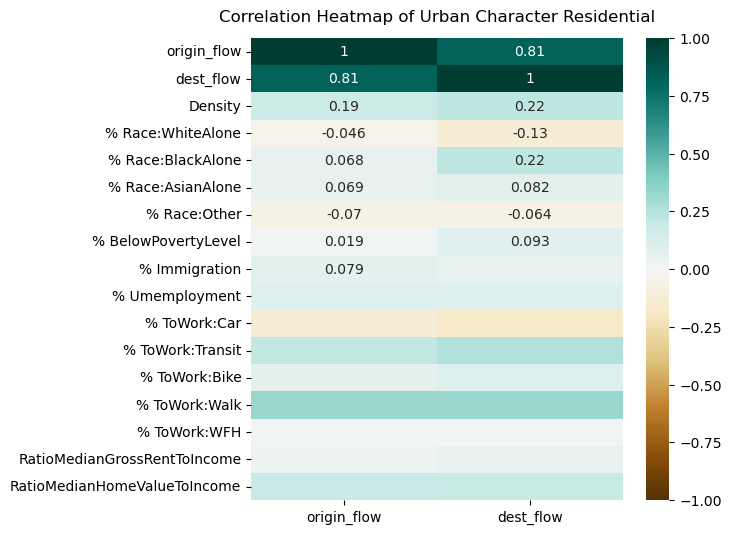

In [16]:
plt.figure(figsize=(6, 6))
ucr_hm = sns.heatmap(correlation_matrices['Urban Character Residential'][['origin_flow','dest_flow']], 
                     vmin=-1, vmax=1, annot=True,cmap='BrBG')
ucr_hm.set_title('Correlation Heatmap of Urban Character Residential', fontdict={'fontsize':12}, pad=12);

In **Urban Character Residential**, OD flows are slightly higher correlated with the percentage of the population *using transit and walking to work*. This correlation suggests that more people choose transit and walking modes of transportation for their daily commute, leading to higher OD flows associated with them.

## 3.1.2 Intensive Urban Area

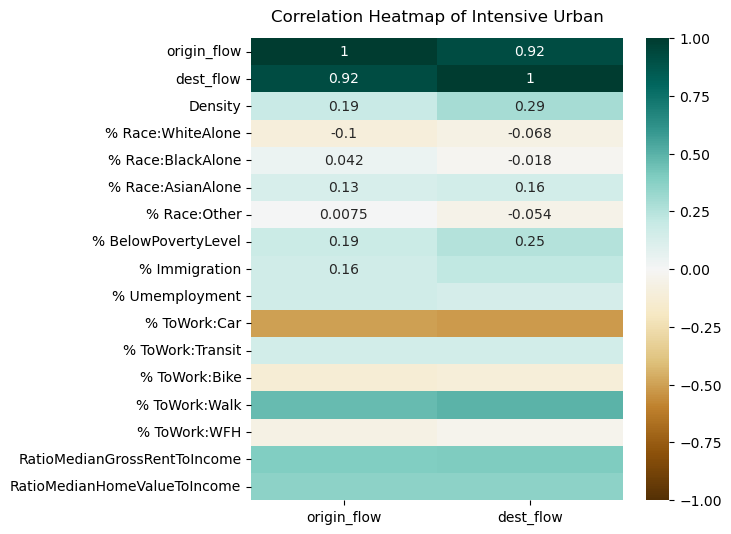

In [17]:
plt.figure(figsize=(6, 6))
iu_hm = sns.heatmap(correlation_matrices['Intensive Urban'][['origin_flow','dest_flow']], 
                     vmin=-1, vmax=1, annot=True,cmap='BrBG')
iu_hm.set_title('Correlation Heatmap of Intensive Urban', fontdict={'fontsize':12}, pad=12);

In **Intensive Urban**, OD flows are positively correlated with *To Work by Walk, Ratio Rent to Income, and Ratio House Value to Income*,and negatively correlated with *Going To Work by Car*. This indicates a preference for walking as a mode of transportation in these areas in contrast to driving. Also, if the cost of renting and house value relative to income is higher, there are increased OD flows.

## 3.1.3 Industrial Area

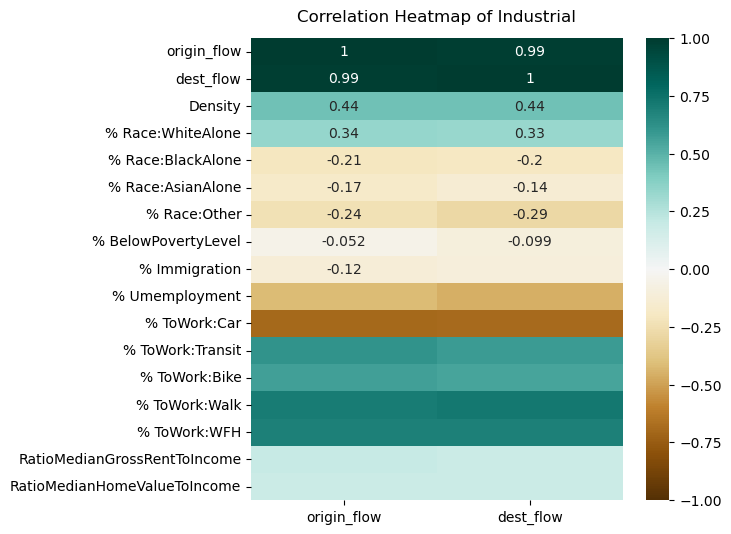

In [18]:
plt.figure(figsize=(6, 6))
in_hm = sns.heatmap(correlation_matrices['Industrial'][['origin_flow','dest_flow']], 
                     vmin=-1, vmax=1, annot=True,cmap='BrBG')
in_hm.set_title('Correlation Heatmap of Industrial', fontdict={'fontsize':12}, pad=12);

In **Industrial Areas**,  *All Transportation modes to work* have strong positive correlations with OD flows, except car that is strong negative. *Unemployment* also shows a noticeable negative correlation with OD flows. If percentages of alternative modes are higher, the OD flows are higher. This reflects that population a reliance on alternative modes of transportation to work. However, if unemployment is lower, the OD flows are higher.

## 3.1.4 Other Areas

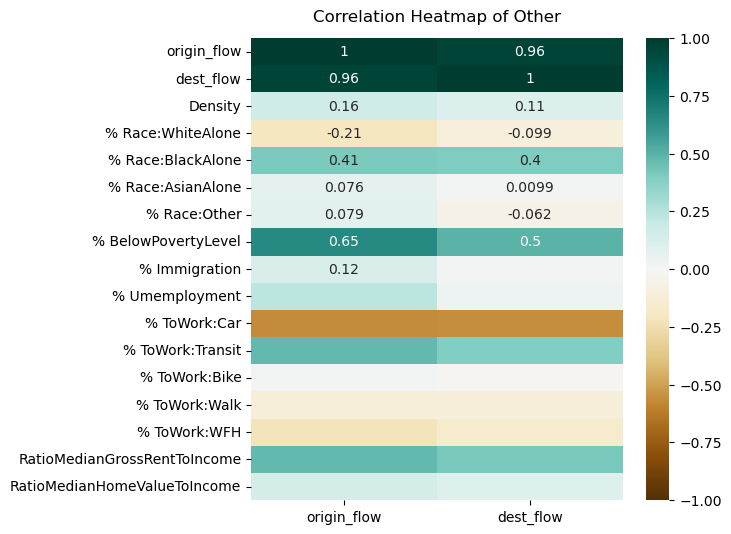

In [19]:
plt.figure(figsize=(6, 6))
in_hm = sns.heatmap(correlation_matrices['Other'][['origin_flow','dest_flow']], 
                     vmin=-1, vmax=1, annot=True,cmap='BrBG')
in_hm.set_title('Correlation Heatmap of Other', fontdict={'fontsize':12}, pad=12);

In **Other Areas**,  *the Percentage of Black race, the Percentage Below Poverty, and Rent/Income have strong positive correlations with OD flows. *Driving to work* also shows a strong negative correlation with OD flows. This indicates that if areas are populated by Black people, below poverty, or transit users, their OD flows are higher as well.

# 3.2 OLS

Linear regression is a statistical technique used to describe relationships among variables. It can predict the relationship between variables by assuming a linear connection between the one or several independent variables (x) and dependent variable (y). The formula is given as:

Y = $B_0$ + $B_1X_1$ + $B_1X_2$ + ... + $B_pX_p$ + $\epsilon$

Where 
* Y = the dependent or predicted variable
* $B_0$ = the y-intercept
* $B_1$ and $B_2$ = regression coefficients representing the change in y relative to a one-unit change in $X_1$ and $X_2$, respectively
* $B_p$ = the slope coefficient for each independent variable
* $\epsilon$ = the model’s random error (residual) term

This study uses regression analysis to answer the following questions
1) Does race relate with trip number?
2) What type of land use has impact to the number of trip origin and trip destination?
3) Which factor effect number of the trip more: unemployment or poverty level?
4) What type of land use has higher number of transit to work use? what about WFH?

## 3.2.0 Clean data
Remove rows with NaN value and land use data that is 'N/A' type or 'Undesignated' type

In [20]:
all_gdf_lr = all_gdf.dropna()
all_gdf_lr = all_gdf_lr[all_gdf_lr['land_use'] != 'N/A']
all_gdf_lr = all_gdf_lr[all_gdf_lr['land_use'] != 'Undesignated']

Inspecting land use type data distribution 

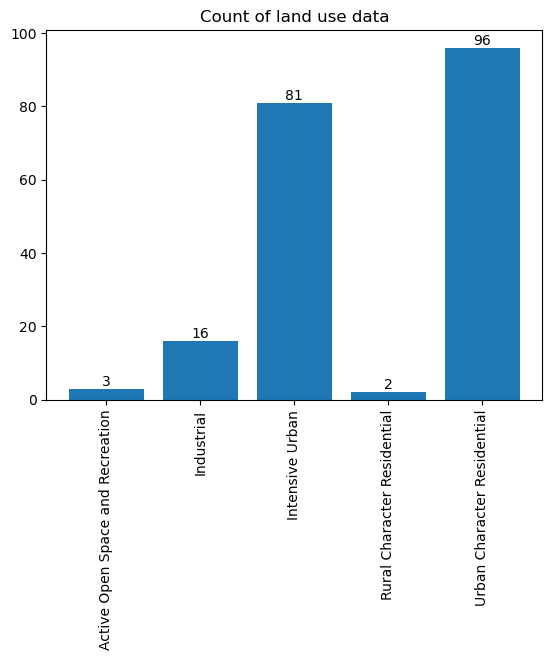

In [21]:
grouped_data = all_gdf_lr.groupby(['land_use'])['land_use'].count()
land_use_categories = grouped_data.index
heights = grouped_data.values
plt.bar(land_use_categories, heights)
plt.xticks(rotation='vertical');
plt.title('Count of land use data');

for i, value in enumerate(heights):
    plt.text(i, value + 0.1, str(value), ha='center', va='bottom')

## 3.2.1 Race VS Trip Number

The dependent variable is the sum of original flow and destination flow. The independent variables are percentage of each race in each census

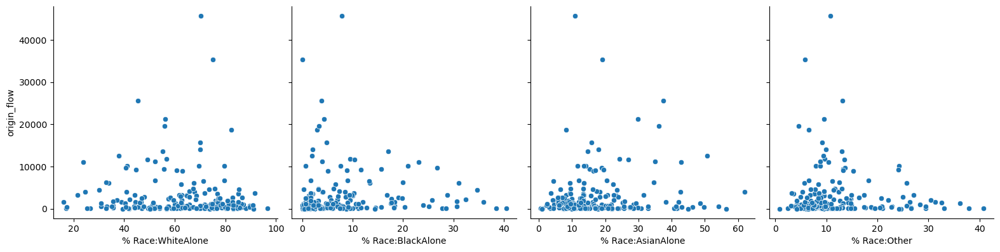

In [22]:
# Observe Data
sns.pairplot(all_gdf_lr, x_vars=['% Race:WhiteAlone','% Race:BlackAlone','% Race:AsianAlone','% Race:Other'], y_vars = 'origin_flow', size = 4, kind = 'scatter' )
plt.show()

In [23]:
X = all_gdf_lr[['% Race:WhiteAlone','% Race:BlackAlone','% Race:AsianAlone','% Race:Other']]

In [24]:
y = all_gdf_lr['origin_flow']+all_gdf_lr['dest_flow']

In [25]:
# fit linear regression model
model = sm.OLS(y, X).fit()

# print out the statistics
model.summary()

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.023
Model:                            OLS   Adj. R-squared:                  0.008
Method:                 Least Squares   F-statistic:                     1.539
Date:                Thu, 07 Mar 2024   Prob (F-statistic):              0.206
Time:                        16:43:22   Log-Likelihood:                -2118.7
No. Observations:                 198   AIC:                             4245.
Df Residuals:                     194   BIC:                             4258.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
% Race:WhiteAlone    49.7496     19.213      2.589      0.010      11.856      87.644
% Race:BlackAlone   141.2025     99.646      1.417      0.158     -55.326     337.731
% Race:AsianAlone   147.1504     56.369      2.610      0.010      35.976     258.325
% Race:Other        -80.6080    101.507     -0.794      0.428    -280.807     119.591
==============================================================================
Omnibus:                      198.933   Durbin-Watson:                   2.009
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             4251.077
Skew:                           3.975   Prob(JB):                         0.00
Kurtosis:                      24.262   Cond. No.                         11.1
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<span style="color:blue"> A positive coefficient indicates that as the predictor variable increases, the Target variable also increases. From the result, as percentage of one race in census increase, the number of total trip also increase. Census with most majority is Asian trend to produce trip the most</span>

Plots below show relationship of race dominant and number of trip origin

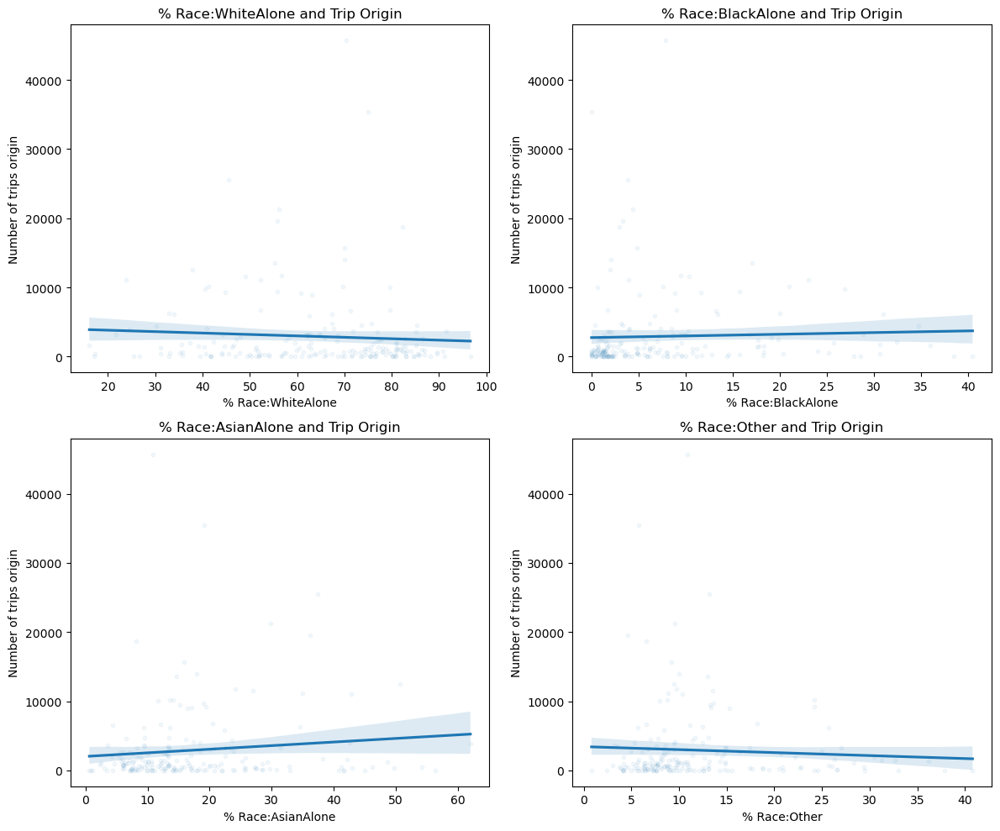

In [26]:
x_val = ['% Race:WhiteAlone','% Race:BlackAlone','% Race:AsianAlone','% Race:Other']

# Create subplots
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

for i, item in enumerate(x_val):
    row = i // 2
    col = i % 2
    sns.regplot(x=item, y='origin_flow', data=all_gdf_lr, scatter_kws={"alpha": 0.05, "s": 10}, ax=axes[row, col])
    axes[row, col].set_title(f'{item} and Trip Origin')
    axes[row, col].set_xlabel(item)
    axes[row, col].set_ylabel('Number of trips origin')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

## 3.2.2 Trip Number vs Land Use Type

This analysis use original flow and destination flow as dependent value. The independent variables are land use type (categorical value)

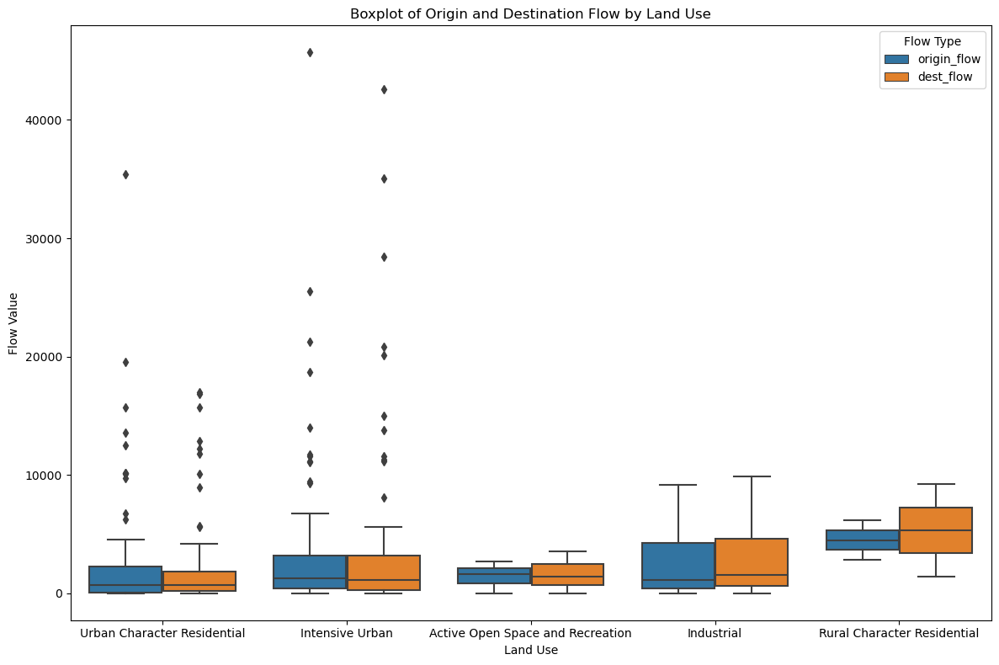

In [27]:
import seaborn as sns
df_long = pd.melt(all_gdf_lr, id_vars='land_use', value_vars=['origin_flow', 'dest_flow'], var_name='Flow Type', value_name='Flow Value')

plt.figure(figsize=(12, 8))
sns.boxplot(x='land_use', y='Flow Value', hue='Flow Type', data=df_long)

plt.title('Boxplot of Origin and Destination Flow by Land Use')
plt.xlabel('Land Use')
plt.ylabel('Flow Value')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

In [28]:
X = all_gdf_lr[['land_use']]
y = all_gdf_lr['origin_flow']+all_gdf_lr['dest_flow']

X = pd.get_dummies(data=X, drop_first=True)
X.head()

,land_use_Industrial,land_use_Intensive Urban,land_use_Rural Character Residential,land_use_Urban Character Residential
0,0,0,0,1
9,0,1,0,0
12,0,0,0,0
13,1,0,0,0
14,0,0,0,1


In [29]:
# fit linear regression model
model = sm.OLS(y, X).fit()

# print out the statistics
model.summary()

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                      y   R-squared (uncentered):                   0.236
Model:                            OLS   Adj. R-squared (uncentered):              0.220
Method:                 Least Squares   F-statistic:                              14.94
Date:                Thu, 07 Mar 2024   Prob (F-statistic):                    1.16e-10
Time:                        16:43:24   Log-Likelihood:                         -2119.2
No. Observations:                 198   AIC:                                      4246.
Df Residuals:                     194   BIC:                                      4260.
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
========================================================================================================
                                           coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
land_use_Industrial                   5250.1097   2718.834      1.931      0.055    -112.158    1.06e+04
land_use_Intensive Urban              7460.4255   1208.371      6.174      0.000    5077.196    9843.655
land_use_Rural Character Residential  9779.1678   7690.023      1.272      0.205   -5387.615    2.49e+04
land_use_Urban Character Residential  4481.7169   1109.959      4.038      0.000    2292.580    6670.853
==============================================================================
Omnibus:                      191.464   Durbin-Watson:                   2.040
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             3517.431
Skew:                           3.816   Prob(JB):                         0.00
Kurtosis:                      22.186   Cond. No.                         6.93
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<span style="color:blue"> Box plot shows that 'Intensive urban resident' and 'Urban Characteristic Resident' has wide range of the number of trip, however, most of data are outliner which indicated that there are some special area where there are trip generated more than usual. From regression analysis, it can indicate that rural residential area are likely to generate amouth of trips. This make sense as facilities might be limited in rural area so people need to make trip to do their activities  </span>

## 3.2.3 Which factor effect number of the trip more: unemployment or poverty level?

This analysis use original flow and destination flow as dependent value. The independent variables are percentage of unemployment population and percentage of population with BelowPovertyLevel

Text(0.5, 1.0, '% Unemployment vs % BelowPovertyLevel')

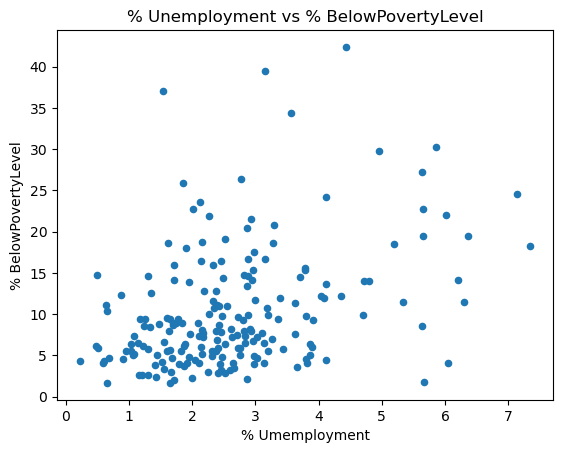

In [30]:
# Inspect the relation of unemployment and poverty level
all_gdf_lr.plot.scatter(x='% Umemployment',y='% BelowPovertyLevel')
plt.title('% Unemployment vs % BelowPovertyLevel')

In [31]:
X = all_gdf_lr[['% Umemployment','% BelowPovertyLevel']]
y = all_gdf_lr['origin_flow']+all_gdf_lr['dest_flow']

In [32]:
# fit linear regression model
model = sm.OLS(y, X).fit()

# print out the statistics
model.summary()

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                      y   R-squared (uncentered):                   0.234
Model:                            OLS   Adj. R-squared (uncentered):              0.226
Method:                 Least Squares   F-statistic:                              29.89
Date:                Thu, 07 Mar 2024   Prob (F-statistic):                    4.69e-12
Time:                        16:43:25   Log-Likelihood:                         -2119.4
No. Observations:                 198   AIC:                                      4243.
Df Residuals:                     196   BIC:                                      4249.
Df Model:                           2                                                  
Covariance Type:            nonrobust                                                  
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
% Umemployment        894.5723    461.404      1.939      0.054     -15.381    1804.526
% BelowPovertyLevel   282.8231    108.976      2.595      0.010      67.907     497.739
==============================================================================
Omnibus:                      190.443   Durbin-Watson:                   2.015
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             3486.356
Skew:                           3.785   Prob(JB):                         0.00
Kurtosis:                      22.112   Cond. No.                         7.84
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

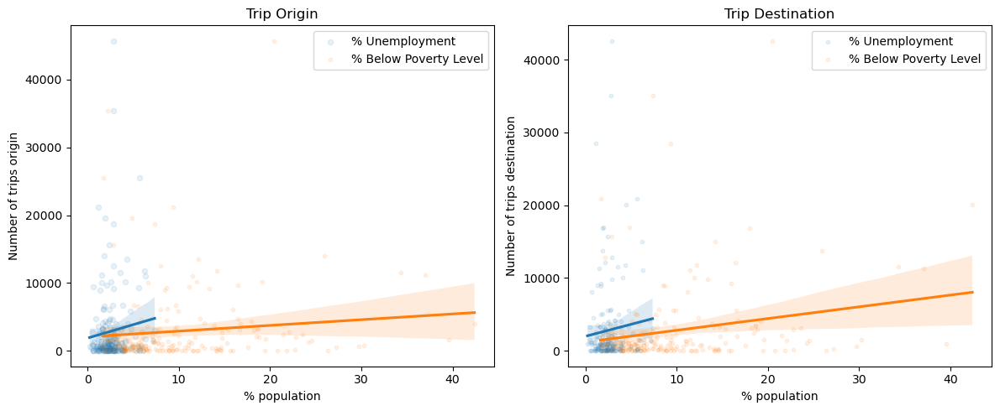

In [33]:
# Create subplots
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Regression plot for 'Trip Origin'
sns.regplot(x='% Umemployment', y='origin_flow', data=all_gdf_lr, scatter_kws={"alpha": 0.1, "s": 20}, ax=axes[0], label='% Unemployment')
sns.regplot(x='% BelowPovertyLevel', y='origin_flow', data=all_gdf_lr, scatter_kws={"alpha": 0.1, "s": 10}, ax=axes[0], label='% Below Poverty Level')
axes[0].set_title('Trip Origin')
axes[0].set_xlabel('% population')
axes[0].set_ylabel('Number of trips origin')

# Regression plot for 'Trip Destination'
sns.regplot(x='% Umemployment', y='dest_flow', data=all_gdf_lr, scatter_kws={"alpha": 0.1, "s": 10}, ax=axes[1], label='% Unemployment')
sns.regplot(x='% BelowPovertyLevel', y='dest_flow', data=all_gdf_lr, scatter_kws={"alpha": 0.1, "s": 10}, ax=axes[1], label='% Below Poverty Level')
axes[1].set_title('Trip Destination')
axes[1].set_xlabel('% population')
axes[1].set_ylabel('Number of trips destination')

axes[0].legend()
axes[1].legend()

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

<span style="color:blue"> From scatter plot, percentage of unemployment and population with below poverty level are related. However, these two factor has different effect to the number of trip. From linear regression analysis, area with higher unemployment makes more trip than area with people below poverty level. This can be concluded that people below poverty cannot affroad travel expense than unemployememt people</span>

## 3.2.4 What type of land use has higher number of transit to work use? what about WFH?

This analysis use percentage of people who use transit to work or percentage of people who work from home (WFH) as dependent value. The independent variables are land use type (categorial)

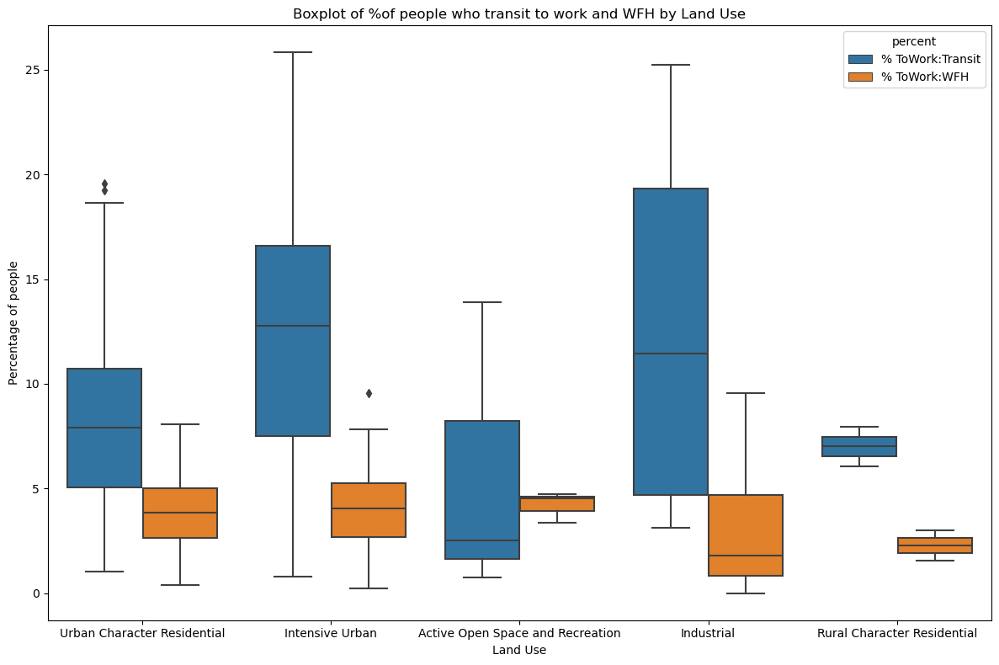

In [34]:
import seaborn as sns
df_long = pd.melt(all_gdf_lr, id_vars='land_use', value_vars=['% ToWork:Transit', '% ToWork:WFH'], var_name='percent', value_name='% of people')

plt.figure(figsize=(12, 8))
sns.boxplot(x='land_use', y='% of people', hue='percent', data=df_long)

plt.title('Boxplot of %of people who transit to work and WFH by Land Use')
plt.xlabel('Land Use')
plt.ylabel('Percentage of people')

# Adjust layout
plt.tight_layout()

# Show the plot
plt.show()

In [35]:
# Transit to work
X = all_gdf_lr[['land_use']]
y = all_gdf_lr['% ToWork:Transit']

X = pd.get_dummies(data=X, drop_first=True)

In [36]:
# fit linear regression model
model = sm.OLS(y, X).fit()

# print out the statistics
model.summary()

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:       % ToWork:Transit   R-squared (uncentered):                   0.792
Model:                            OLS   Adj. R-squared (uncentered):              0.788
Method:                 Least Squares   F-statistic:                              184.6
Date:                Thu, 07 Mar 2024   Prob (F-statistic):                    5.77e-65
Time:                        16:43:26   Log-Likelihood:                         -611.87
No. Observations:                 198   AIC:                                      1232.
Df Residuals:                     194   BIC:                                      1245.
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
========================================================================================================
                                           coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
land_use_Industrial                     12.0806      1.343      8.992      0.000       9.431      14.730
land_use_Intensive Urban                12.2899      0.597     20.583      0.000      11.112      13.468
land_use_Rural Character Residential     7.0098      3.800      1.845      0.067      -0.484      14.504
land_use_Urban Character Residential     8.3243      0.548     15.178      0.000       7.243       9.406
==============================================================================
Omnibus:                        4.138   Durbin-Watson:                   1.520
Prob(Omnibus):                  0.126   Jarque-Bera (JB):                4.141
Skew:                           0.320   Prob(JB):                        0.126
Kurtosis:                       2.694   Cond. No.                         6.93
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [37]:
# WFH
X = all_gdf_lr[['land_use']]
y = all_gdf_lr['% ToWork:WFH']

X = pd.get_dummies(data=X, drop_first=True)

In [38]:
# fit linear regression model
model = sm.OLS(y, X).fit()

# print out the statistics
model.summary()

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:           % ToWork:WFH   R-squared (uncentered):                   0.799
Model:                            OLS   Adj. R-squared (uncentered):              0.795
Method:                 Least Squares   F-statistic:                              192.8
Date:                Thu, 07 Mar 2024   Prob (F-statistic):                    2.04e-66
Time:                        16:43:26   Log-Likelihood:                         -411.41
No. Observations:                 198   AIC:                                      830.8
Df Residuals:                     194   BIC:                                      844.0
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
========================================================================================================
                                           coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
land_use_Industrial                      2.8205      0.488      5.778      0.000       1.858       3.783
land_use_Intensive Urban                 4.0694      0.217     18.758      0.000       3.642       4.497
land_use_Rural Character Residential     2.2782      1.381      1.650      0.101      -0.445       5.001
land_use_Urban Character Residential     3.9001      0.199     19.572      0.000       3.507       4.293
==============================================================================
Omnibus:                        7.055   Durbin-Watson:                   1.795
Prob(Omnibus):                  0.029   Jarque-Bera (JB):                6.978
Skew:                           0.457   Prob(JB):                       0.0305
Kurtosis:                       3.096   Cond. No.                         6.93
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

<span style="color:blue"> Percentage of people who WFH is lower than people who transit to work in every land use type. People mostly use transit to work in Industrial and Intencive Urban area. As these area mostly have good transit facility and mainly serving for people who working. However, people who live in intenseive urban area tend to WFH the most. This indicated that intensive urban area must have both office and residential area. </span>

# 3.3 Mapping Analysis
These graphs will provide insight on the relationship between OD flows, demographics, and land use.

### What is the relationship between transit flow patterns and demographics?
Transit OD flows are plotted via [`scikit-mobility`](https://github.com/scikit-mobility/scikit-mobility), which is a Python library for human mobility analysis. Their visualizations are built on top of `folium`.

In [39]:
# convert to gdf
all_gdf = gpd.GeoDataFrame(all_gdf)
all_gdf = all_gdf.set_crs('EPSG:4326')

In [40]:
# create tesselation for skmob
tessellation = all_gdf.reset_index().rename(columns={'tractid':'tile_ID'})

In [41]:
# create folium map
m = folium.Map(location=(47.5480, -121.9836), tiles=None, zoom_start=10)

'''
names = ['Density','% Race:WhiteAlone', '% Race:BlackAlone', '% Race:AsianAlone',
       '% Race:Other', '% BelowPovertyLevel', '% Immigration',
       '% Umemployment', '% ToWork:Car', '% ToWork:Transit', '% ToWork:Bike',
       '% ToWork:Walk', '% ToWork:WFH', 'RatioMedianGrossRentToIncome',
       'RatioMedianHomeValueToIncome']
'''
names = ['% Race:BlackAlone', '% BelowPovertyLevel', '% Umemployment', '% ToWork:Transit', '% ToWork:WFH']

# plot each function with a radio button to toggle on/off
for nm in names:
    fg = folium.FeatureGroup(name=nm, overlay = False).add_to(m)
    choro = folium.Choropleth(geo_data=all_gdf,
        data=all_gdf,
        columns=["Tract", nm],
        key_on="feature.properties.Tract",
        fill_color="YlGn",
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name=nm,
        name=nm).geojson.add_to(fg)
    
#     gjson = folium.GeoJson(data=all_gdf, 
#                            tooltip=folium.GeoJsonTooltip(fields=[nm],
#                                                         labels=False,
#                                                         sticky=True)).add_to(choro)

# plot OD flows
fdf = skmob.FlowDataFrame(od_transit_flows, tessellation=tessellation, tile_id='tile_ID', 
                          origin='origin', destination='destination', flow='flow')
flow_plot = fdf.plot_flows(min_flow=1, flow_weight=0.05, flow_exp=0.9, flow_color='red', opacity=0.4, 
               tile_popup=False,map_f=m)

# set colormap
colormap = cm.LinearColormap(vmin=0, vmax=1, colors=["yellow", "green"], caption='Percent')
colormap.caption = "Magnitude, scaled"
colormap.add_to(m)

folium.TileLayer('OpenStreetMap', overlay=True).add_to(m)
folium.LayerControl(collapsed=False).add_to(m)
display(m)

Transit OD patterns:
- We observe large flows between Kirkland and Woodinville (locations with large transit stations)
- Many flows come in and out of downtown, even from as far as Federal Way and from the water taxi to Vashon Island
- Important nodes in network appear to be downtown, UW/U District, Bellevue, and the Microsoft campus in Redmond

OD relationship to demographics:
- There appears to be a slight correlation with % Black, lower-income tracts and larger OD flows. From the map, this is not clear if this is due to Black and/or lower-income populations being more reliant on transit, or whether transit stations are being built in areas with larger Black/lower-income areas due to cheaper construction costs. It should also be noted that transit-oriented development tends to gentrify neighborhoods, so these correlations may change over time as neighborhoods gentrify.


### For the top three land uses, are there differences between demographics and transit flows?
| Land Use Type | Number of Tracts|
| ----- | ----|
|Urban Character Residential    |          218 |
|Intensive Urban                 |         106|
|Industrial                       |         21|

In [42]:
# combine N/A and Undesignated into one category
all_gdf['land_use'] = all_gdf['land_use'].replace({
    'N/A': 'Unknown',
    'Undesignated': 'Unknown'
})

# rename origin_flow column for readability
all_gdf = all_gdf.rename(columns={'origin_flow': 'Origin Flow', 'dest_flow': 'Destination Flow'})

In [43]:
# %matplotlib notebook
# %matplotlib inline

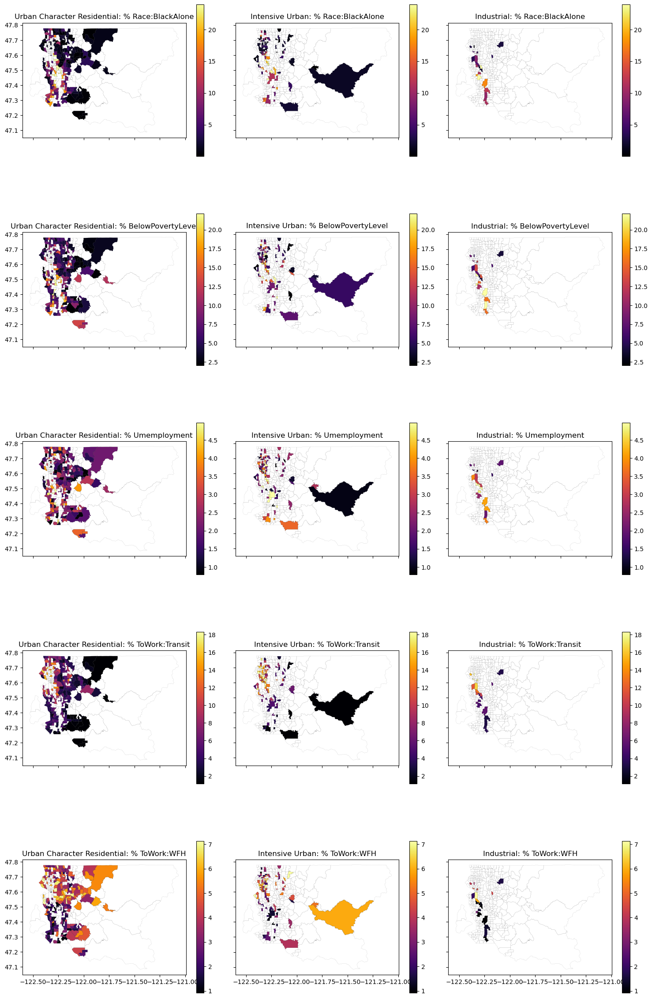

In [46]:
# choropleth maps for demographics, OD flows in each census tract. separate plots for each land use
vars = ['% Race:BlackAlone', 
       '% BelowPovertyLevel', '% Umemployment', '% ToWork:Transit', '% ToWork:WFH']
land_uses = ["Urban Character Residential", "Intensive Urban", "Industrial"]
f, ax = plt.subplots(5,3, figsize=(15,25), sharex=True, sharey=True)
# ax = ax.flatten()
for i in range(len(vars)):
    for j in range(len(land_uses)):
        # plot base census tract map
        all_gdf.plot(facecolor='none', linewidth=0.05, edgecolor='black', ax=ax[i,j])
        all_gdf[all_gdf['land_use'] == land_uses[j]].plot(column=vars[i], legend=True, linewidth=0.1, ax=ax[i,j], edgecolor='black', legend_kwds={'shrink': 0.6},
                                                          cmap='inferno', vmin=all_gdf[vars[i]].quantile(0.05), vmax=all_gdf[vars[i]].quantile(0.95))
        ax[i,j].set_title(f'{land_uses[j]}: {vars[i]}')
f.tight_layout()

Observations:
- A disproportionate amount of Black, low-income, and unemployed individuals live in areas with industrial land uses, or in census tracts adjacent to industrial land uses. This is a reflection of historical redlining practices in Seattle which disadvantaged people of color, and the implications are still present today. There are also signficiant environmental justice concerns (e.g., air quality) living in industrial areas.
- Transit serves intensive urban areas (e.g., Seattle downtown) well, which is reflected by high ridership in those areas. Unsurprisingly, the further from downtown core, the fewer commuters via transit.
- Interestingly enough, very few individuals who live in Industrial areas are unable to work from home. These individuals may be in service jobs where they do not have the flexibility to choose their work location (e.g., manufacturing jobs, service jobs).

# 4. Conclusion

From our analysis, several conclusions can be drawn as follows:

**1) OD flows and demographics**
* A slight correlation exists between % Black, lower-income tracts, and larger OD flows, suggesting potential reliance on transit or station construction in areas with lower costs.

**2) Land use and number of trips**
* In Industrial and Intensive Urban areas, people mostly use transit for commuting, especially those with service jobs that lack the flexibility to work from home.

**3) Justify the amount of transit provided**
* In Intensive Urban areas, people prefer walking over driving, suggesting the presence of adequate facilities for walking. 
* Significant flows occur in and out of downtown areas, indicating high ridership and effective transit service in these intensive urban locations

In [47]:
# export notebook to html
!jupyter nbconvert --to html presentation_notebook.ipynb --no-input

[NbConvertApp] Converting notebook presentation_notebook.ipynb to html
[NbConvertApp] Writing 27707014 bytes to presentation_notebook.html
